<a href="https://colab.research.google.com/github/junduk123/Machine-Learning-Task/blob/main/Task10/Regression_Model_MLP_Regression.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from torch.utils.data import DataLoader, TensorDataset
import time

In [ ]:
# Load dataset
# Memuat dataset
file_path = "C:/Users/mhafi/Downloads/Documents/winequality-white.csv"
data = pd.read_csv(file_path, delimiter=';')

# Limit dataset to 2000 samples
# Membatasi dataset menjadi 2000 sampel
data = data.sample(n=2000, random_state=42)

C:\Users\mhafi\AppData\Local\Temp\ipykernel_18576\2683566708.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='quality', data=data, palette='viridis')


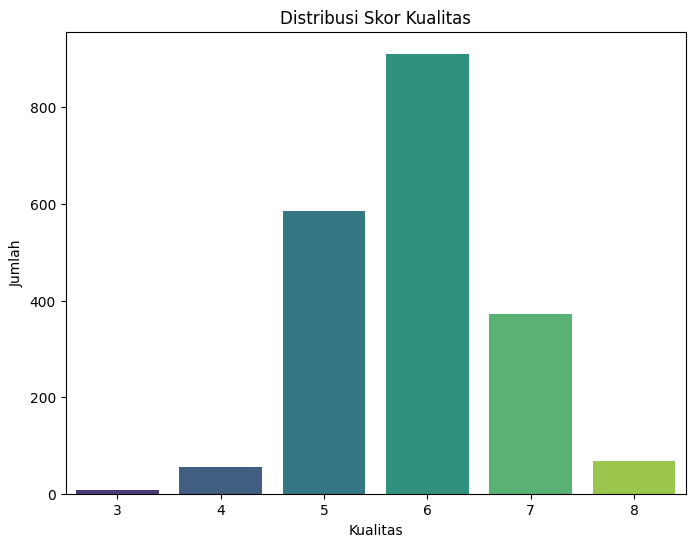

In [ ]:
# Inspect dataset
# Menampilkan distribusi target 'quality'
plt.figure(figsize=(8, 6))
sns.countplot(x='quality', data=data, palette='viridis')
plt.title("Distribusi Skor Kualitas")
plt.xlabel("Kualitas")
plt.ylabel("Jumlah")
plt.show()

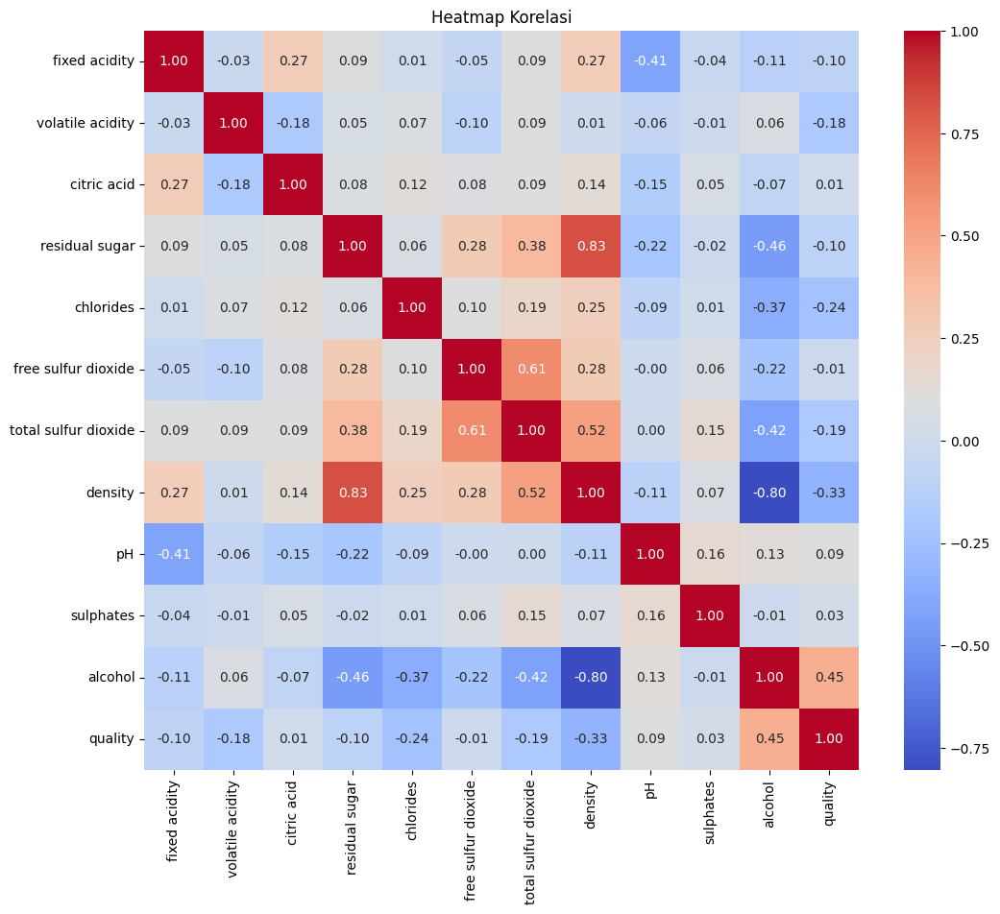

In [ ]:
# Correlation heatmap
# Membuat heatmap korelasi untuk fitur
plt.figure(figsize=(12, 10))
correlation = data.corr()
sns.heatmap(correlation, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Heatmap Korelasi")
plt.show()

In [ ]:
# Prepare features and target
# Memisahkan fitur dan target
X = data.drop(columns=['quality'])
y = data['quality']

# Encode target labels to be 0 to n_classes-1
# Mengkodekan ulang label target
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Normalize features
# Normalisasi fitur menggunakan StandardScaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split dataset
# Membagi dataset menjadi data latih dan uji
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42, stratify=y)

# Convert data to PyTorch tensors
# Mengonversi data ke tensor PyTorch
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.long)
X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test, dtype=torch.long)


In [ ]:
# Define MLP model
# Mendefinisikan model MLP
class MLPClassifier(nn.Module):
    def __init__(self, input_size, hidden_sizes, output_size, activation):
        super(MLPClassifier, self).__init__()
        layers = []
        current_size = input_size
        for hidden_size in hidden_sizes:
            layers.append(nn.Linear(current_size, hidden_size))
            layers.append(activation)
            current_size = hidden_size
        layers.append(nn.Linear(current_size, output_size))
        self.model = nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)

In [ ]:
# Define experiment parameters
# Parameter eksperimen
hidden_layer_configurations = [[4], [8, 16], [32, 64, 64]]
activations = [nn.ReLU(), nn.Sigmoid(), nn.Tanh(), nn.Softmax(dim=1)]
epochs_list = [1, 10, 25, 50, 100, 250]
learning_rates = [10, 1, 0.1, 0.01, 0.001, 0.0001]
batch_sizes = [16, 32, 64, 128, 256, 512]

In [ ]:
# Experiment results storage
# Penyimpanan hasil eksperimen
results = []

for hidden_sizes in hidden_layer_configurations:
    for activation in activations:
        for lr in learning_rates:
            for batch_size in batch_sizes:
                # Prepare DataLoader
                train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
                test_dataset = TensorDataset(X_test_tensor, y_test_tensor)
                train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
                test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

                # Initialize model
                input_size = X_train.shape[1]
                output_size = len(label_encoder.classes_)
                model = MLPClassifier(input_size, hidden_sizes, output_size, activation)

                # Define loss and optimizer
                criterion = nn.CrossEntropyLoss()
                optimizer = optim.Adam(model.parameters(), lr=lr)

                # Train model
                for epochs in epochs_list:
                    model.train()
                    start_time = time.time()
                    for epoch in range(epochs):
                        running_loss = 0.0
                        for inputs, labels in train_loader:
                            optimizer.zero_grad()
                            outputs = model(inputs)
                            loss = criterion(outputs, labels)
                            loss.backward()
                            optimizer.step()
                            running_loss += loss.item()
                        elapsed_time = time.time() - start_time
                        print(f"Hidden Sizes: {hidden_sizes}, Activation: {activation.__class__.__name__}, Learning Rate: {lr}, Batch Size: {batch_size}, Epoch: {epoch + 1}/{epochs}, Loss: {running_loss / len(train_loader):.4f}, Time: {elapsed_time:.2f}s")

                    # Evaluate model
                    model.eval()
                    correct = 0
                    total = 0
                    with torch.no_grad():
                        for inputs, labels in test_loader:
                            outputs = model(inputs)
                            _, predicted = torch.max(outputs, 1)
                            total += labels.size(0)
                            correct += (predicted == labels).sum().item()

                    test_accuracy = correct / total * 100

                    # Save results
                    results.append({
                        'hidden_sizes': hidden_sizes,
                        'activation': activation.__class__.__name__,
                        'learning_rate': lr,
                        'batch_size': batch_size,
                        'epochs': epochs,
                        'test_accuracy': test_accuracy
                    })

# Convert results to DataFrame and save
# Mengonversi hasil ke DataFrame
results_df = pd.DataFrame(results)

Hidden Sizes: [4], Activation: ReLU, Learning Rate: 10, Batch Size: 16, Epoch: 1/1, Loss: 83.9160, Time: 0.21s
Hidden Sizes: [4], Activation: ReLU, Learning Rate: 10, Batch Size: 16, Epoch: 1/10, Loss: 10.9286, Time: 0.06s
Hidden Sizes: [4], Activation: ReLU, Learning Rate: 10, Batch Size: 16, Epoch: 2/10, Loss: 2.5049, Time: 0.11s
Hidden Sizes: [4], Activation: ReLU, Learning Rate: 10, Batch Size: 16, Epoch: 3/10, Loss: 2.4111, Time: 0.17s
Hidden Sizes: [4], Activation: ReLU, Learning Rate: 10, Batch Size: 16, Epoch: 4/10, Loss: 1.9859, Time: 0.23s
Hidden Sizes: [4], Activation: ReLU, Learning Rate: 10, Batch Size: 16, Epoch: 5/10, Loss: 2.1882, Time: 0.28s
Hidden Sizes: [4], Activation: ReLU, Learning Rate: 10, Batch Size: 16, Epoch: 6/10, Loss: 1.9625, Time: 0.34s
Hidden Sizes: [4], Activation: ReLU, Learning Rate: 10, Batch Size: 16, Epoch: 7/10, Loss: 2.3512, Time: 0.40s
Hidden Sizes: [4], Activation: ReLU, Learning Rate: 10, Batch Size: 16, Epoch: 8/10, Loss: 2.2488, Time: 0.46s


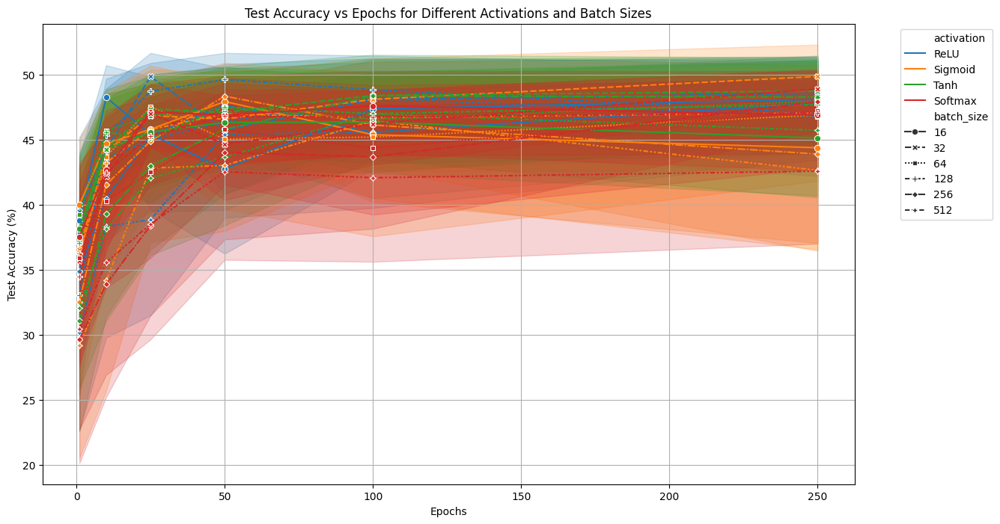

In [ ]:
# Visualize results
# Visualisasi hasil eksperimen
plt.figure(figsize=(14, 8))
sns.lineplot(data=results_df, x='epochs', y='test_accuracy', hue='activation', style='batch_size', markers=True)
plt.title('Test Accuracy vs Epochs for Different Activations and Batch Sizes')
plt.xlabel('Epochs')
plt.ylabel('Test Accuracy (%)')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

In [ ]:
# # Additional visualization: Test Accuracy per Hidden Layer Configuration
# plt.figure(figsize=(14, 8))
# sns.boxplot(data=results_df, x='hidden_sizes', y='test_accuracy', hue='activation')
# plt.title('Test Accuracy per Hidden Layer Configuration')
# plt.xlabel('Hidden Layer Configurations')
# plt.ylabel('Test Accuracy (%)')
# plt.xticks(rotation=45)
# plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
# plt.grid(True)
# plt.show()

results_df.to_csv('mlp_experiment_results.csv', index=False)
print("Hasil eksperimen disimpan ke 'mlp_experiment_results.csv'")

Hasil eksperimen disimpan ke 'mlp_experiment_results.csv'
